In [9]:
import pandas as pd
import numpy as np
import opendatasets as od
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [10]:
# load data
od.download("https://www.kaggle.com/datasets/nicapotato/womens-ecommerce-clothing-reviews")
df = pd.read_csv("womens-ecommerce-clothing-reviews/Womens Clothing E-Commerce Reviews.csv")
df.sample(5)

Skipping, found downloaded files in "./womens-ecommerce-clothing-reviews" (use force=True to force download)


,Unnamed: 0,Clothing ID,Age,Title,Review Text,Rating,Recommended IND,Positive Feedback Count,Division Name,Department Name,Class Name
1882,1882,371,38,Disappointed,"Cute and very soft, but the elastic wasn't sew...",1,0,1,Initmates,Intimate,Lounge
14023,14023,621,32,NaN,Love the dress but ended up returning it as i'...,5,1,1,General Petite,Intimate,Lounge
19042,19042,952,46,Beautiful piece!,This is so beautiful and looks hand made but i...,5,1,2,General Petite,Tops,Sweaters
14639,14639,882,64,Just right,I purchased the washed-out blue color. it is l...,5,1,0,General,Tops,Knits
12809,12809,1081,45,NaN,NaN,5,1,0,General,Dresses,Dresses


In [11]:
df.describe(include="all").T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Unnamed: 0,23486.0,NaN,NaN,NaN,11742.5,6779.968547,0.0,5871.25,11742.5,17613.75,23485.0
Clothing ID,23486.0,NaN,NaN,NaN,918.118709,203.29898,0.0,861.0,936.0,1078.0,1205.0
Age,23486.0,NaN,NaN,NaN,43.198544,12.279544,18.0,34.0,41.0,52.0,99.0
Title,19676,13993,Love it!,136,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Review Text,22641,22634,Perfect fit and i've gotten so many compliment...,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Rating,23486.0,NaN,NaN,NaN,4.196032,1.110031,1.0,4.0,5.0,5.0,5.0
Recommended IND,23486.0,NaN,NaN,NaN,0.822362,0.382216,0.0,1.0,1.0,1.0,1.0
Positive Feedback Count,23486.0,NaN,NaN,NaN,2.535936,5.702202,0.0,0.0,1.0,3.0,122.0
Division Name,23472,3,General,13850,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Department Name,23472,6,Tops,10468,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
df[["Clothing ID","Recommended IND"]] = df[["Clothing ID","Recommended IND"]].astype(str)
df = df.drop('Unnamed: 0', axis=1)
df = df.dropna(subset=['Division Name', 'Department Name', 'Class Name'])
df.describe(include="all").T


,count,unique,top,freq,mean,std,min,25%,50%,75%,max
Clothing ID,23472,1199,1078,1024,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Age,23472.0,NaN,NaN,NaN,43.200707,12.280913,18.0,34.0,41.0,52.0,99.0
Title,19663,13984,Love it!,136,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Review Text,22628,22621,Perfect fit and i've gotten so many compliment...,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Rating,23472.0,NaN,NaN,NaN,4.195552,1.110188,1.0,4.0,5.0,5.0,5.0
Recommended IND,23472,2,1,19300,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Positive Feedback Count,23472.0,NaN,NaN,NaN,2.537151,5.703597,0.0,0.0,1.0,3.0,122.0
Division Name,23472,3,General,13850,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Department Name,23472,6,Tops,10468,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Class Name,23472,20,Dresses,6319,NaN,NaN,NaN,NaN,NaN,NaN,NaN


array([[<AxesSubplot:title={'center':'Age'}>,
        <AxesSubplot:title={'center':'Rating'}>],
       [<AxesSubplot:title={'center':'Positive Feedback Count'}>,
        <AxesSubplot:>]], dtype=object)

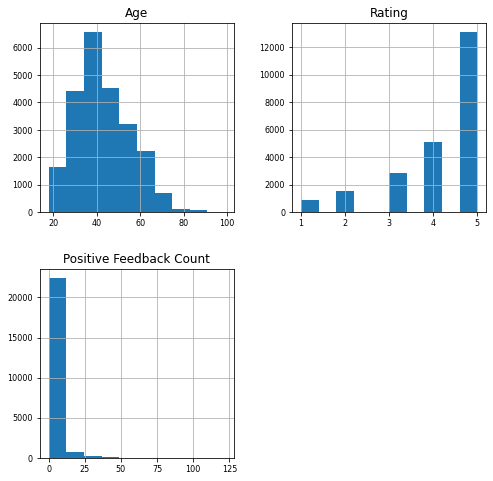

In [13]:
numerical_columns = ["Age","Rating","Positive Feedback Count"]
df[numerical_columns].hist(figsize=(8,8), xlabelsize=8, ylabelsize=8)


In [14]:
px.violin(df,  y="Age", box=True,hover_data=df.columns, width=500, height=500)

In [15]:

fig = make_subplots(rows=1, cols=3)
for i,c in enumerate(numerical_columns):
        fig.add_trace(go.Violin(y=df[c], box_visible=True, meanline_visible=True, name=df[c].name), row = 1, col = i+1 )
fig.update_layout(height=500, width=800, title_text="Numerical Columns Violin Plot")  
fig.show()

In [18]:
categorical_columns = ["Recommended IND","Division Name","Department Name", "Class Name"]
fig = make_subplots(rows=len(categorical_columns), cols=2,shared_yaxes="columns")
for i,c in enumerate(categorical_columns):
        fig.add_trace(go.Histogram(x=df[c],  name=df[c].name, textangle = 90, texttemplate = "%{y:,.0f}"), row =  i+1, col = 1)
        fig.update_xaxes(title_text="Count of {}".format(df[c].name), row =  i+1, col = 1)
        fig.add_trace(go.Histogram(x=df[c],  name=df[c].name, histnorm="percent", texttemplate = "%{y:.2f}", textangle = 90), row =  i+1, col = 2 )
        fig.update_xaxes(title_text="Percentage of {}".format(df[c].name), row =  i+1, col = 2)
fig.update_layout(width=1000,height=1000, title_text="Categorical Columns", showlegend=False, font=dict(size=8))  
fig.show()

In [ ]:
fig = px.violin(df["Clothing ID"].value_counts(),box = True, width = 800)
fig.show()
fig = px.histogram(df["Clothing ID"].value_counts(),width = 800)
fig.show()

In [ ]:
sum(df["Clothing ID"].value_counts()>16)

179

In [ ]:
fig = px.histogram(df,x="Rating",y="Department Name", color='Division Name',histfunc='count', barnorm="percent", text_auto= True, orientation = 'h', width=800, height=500)
fig.show()

fig = px.histogram(df,y="Rating",x="Division Name",facet_col = "Department Name",histfunc='count', histnorm="", text_auto= True, orientation = 'v', facet_col_wrap  = 3, width=800, height=800)
fig.show()

In [ ]:
# fig = px.histogram(df,x="Rating",y="Department Name", color='Division Name',histfunc='count', barnorm="percent", text_auto= True, orientation = 'h', width=800, height=500)
# fig.show()

fig = px.histogram(df,x="Clothing ID",facet_col = "Department Name",histfunc='count', histnorm="", text_auto= True, orientation = 'v', facet_col_wrap  = 3, width=800, height=800)
fig.show()

In [ ]:
fig = px.histogram(df,y="Rating",x="Division Name", barmode='group',histfunc='avg',text_auto=True, width=800)
fig.show()

fig = px.histogram(df,y="Rating",x="Department Name", barmode='group',histfunc='avg',text_auto=True, width=800, )
fig.show()

fig = px.histogram(df,y="Rating",x="Division Name", color='Department Name', barmode='group',histfunc='avg',text_auto=True, width=800)
fig.show()

In [ ]:
fig = px.histogram(df,y="Age",x="Division Name", barmode='group',histfunc='avg',text_auto=True,width=800)
fig.show()

fig = px.histogram(df,y="Age",x="Department Name", barmode='group',histfunc='avg',text_auto=True,width=800)
fig.show()

fig = px.histogram(df,y="Age",x="Division Name", color='Department Name', barmode='group',histfunc='avg',text_auto=True,width=800)
fig.show()

In [ ]:

# Get Clothing ID with more than 16 reviews
id_counts = df["Clothing ID"].value_counts()
high_reviews_id = id_counts[id_counts > 16].index.tolist()

# Filter data frame to only include the top reviews Clothing ID
filtered_df = df[df['Clothing ID'].isin(high_reviews_id)]

# Identify total rows of high reviewed Clothing ID
print(filtered_df.shape)
print(len(set(filtered_df["Clothing ID"]))) # Sanity check if the filter is correct


(20481, 11)
179


In [ ]:
fig = px.histogram(filtered_df,y="Rating",x="Department Name", barmode='group',histfunc='avg',text_auto=True, width=800)
fig.show()
fig = px.histogram(filtered_df,y="Age",x="Department Name", barmode='group',histfunc='avg',text_auto=True, width=800)
fig.show()